In [1]:
!conda info --envs

# conda environments:
#
                         /Users/mmckay/.julia/conda/3
base                     /Users/mmckay/conda
AstronomicalData         /Users/mmckay/conda/envs/AstronomicalData
astroconda               /Users/mmckay/conda/envs/astroconda
astroconda27             /Users/mmckay/conda/envs/astroconda27
astroconda37             /Users/mmckay/conda/envs/astroconda37
marvin_env               /Users/mmckay/conda/envs/marvin_env
marvin_v2             *  /Users/mmckay/conda/envs/marvin_v2
ztf_alert_env            /Users/mmckay/conda/envs/ztf_alert_env



In [17]:
from astropy.io import fits
import numpy as np
import plotly.express as px
import plotly.graph_objects as go
import pandas as pd
import glob
import matplotlib.pyplot as plt
plt.style.use('seaborn-dark')

In [219]:
# Test one D4000 file 
bbrd_fits_file_list = glob.glob("/Users/mmckay/Desktop/research/FMR_MZR/bbrd_MMfits/*.fits")





In [222]:
hdu = fits.open(bbrd_fits_file_list[0])


fig = px.imshow(hdu['GYR_LW'].data, zmin=None, zmax=None, origin='lower', color_continuous_scale='rdbu_r', labels={'color':'D4000 Index'})
fig.add_trace(go.Contour(z=hdu['R/REFF'].data, showscale=False, line=dict(width=10),
                        contours=dict(start=1, end=1, size=1, coloring='lines', showlabels=True,
                            labelfont = dict(size=30, color='black'
                            ),
                        ),
                        line_width=2, name='R/REFF'))
fig.add_trace(go.Contour(z=hdu['ELLIP R'].data, showscale=False, line=dict(width=10),
                        contours=dict(start=1, end=3, size=2, coloring='lines', showlabels=True,
                            labelfont = dict(size=20, color='white'
                            ),
                        ),
                        line_width=2, name='ELLIP R'))

fig.update_layout(width=1000, height=1000)
fig.show()
hdu.info()
hdu.close()

Filename: /Users/mmckay/Desktop/research/FMR_MZR/bbrd_MMfits/8312-12704_MM.fits
No.    Name      Ver    Type      Cards   Dimensions   Format
  0  HALPHA        1 PrimaryHDU      12   (74, 74)   float32   
  1  HALPHA KCORR    2 ImageHDU         9   (74, 74)   float32   
  2  HBETA KCORR    3 ImageHDU         9   (74, 74)   float32   
  3  NII6585 KCORR    4 ImageHDU         9   (74, 74)   float32   
  4  OII3727 KCORR    5 ImageHDU         9   (74, 74)   float32   
  5  OII3729 KCORR    6 ImageHDU         9   (74, 74)   float32   
  6  OIII5008 KCORR    7 ImageHDU         9   (74, 74)   float32   
  7  SII6718 KCORR    8 ImageHDU         9   (74, 74)   float32   
  8  SII6732 KCORR    9 ImageHDU         9   (74, 74)   float32   
  9  HALPHA SNR   10 ImageHDU         9   (74, 74)   float32   
 10  HBETA SNR    11 ImageHDU         9   (74, 74)   float32   
 11  NII6585 SNR   12 ImageHDU         9   (74, 74)   float32   
 12  OII3727 SNR   13 ImageHDU         9   (74, 74)   float32   
 1

/Users/mmckay/conda/envs/marvin_v2/lib/python3.6/site-packages/ipykernel_launcher.py:35: UserWarning:

This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.

/Users/mmckay/conda/envs/marvin_v2/lib/python3.6/site-packages/ipykernel_launcher.py:35: UserWarning:

This figure was using constrained_layout==True, but that is incompatible with subplots_adjust and or tight_layout: setting constrained_layout==False. 



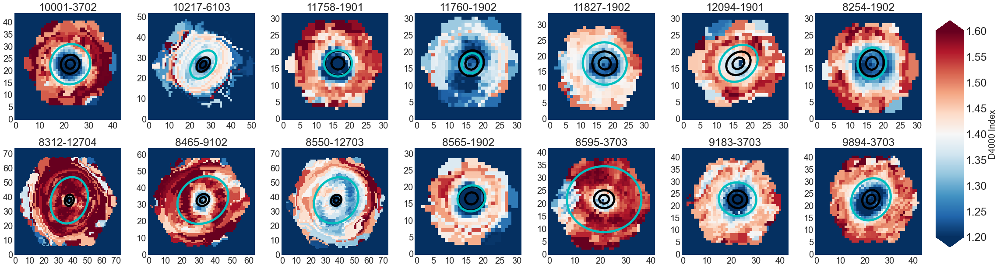

In [450]:
bbrd_fits_file_list = glob.glob("/Users/mmckay/Desktop/research/FMR_MZR/bbrd_MMfits/*.fits")

# Plot Mosaic of BBRD sample D4000 Maps from Pipe3D
fig = plt.figure(figsize=(30,9),constrained_layout=True)

#axs = [ax0,ax1,ax2,ax3,ax4,ax5,ax6,ax7,ax8,ax9,ax10,ax11,ax12,ax13]
for bbrd_fits, num in zip(np.sort(bbrd_fits_file_list), np.linspace(1,14,14)):
    hdu = fits.open(bbrd_fits)
    #print(int(num), bbrd_fits)
    D4000_map = hdu['D4000'].data
    r_reff_map = hdu['R/Reff'].data
    ellip_r_map = hdu['ELLIP R'].data
    plateifu = hdu[0].header['plateifu']
    reff = hdu[0].header['REFF']
    hdu.close()
    ax = fig.add_subplot(2,7,int(num))
    im = ax.imshow(D4000_map, vmin=1.2, vmax=1.6, origin='lower', cmap='RdBu_r')

    ellip_r_contour = ax.contour(ellip_r_map, levels = np.arange(1, 3, 1), origin='lower', colors='k',
    linewidths=5)
    r_reff_contour = ax.contour(r_reff_map, levels = np.arange(1, 2, 1), origin='lower', colors='c',
    linewidths=5)
    #ax.clabel(r_reff_contour, fontsize=9, inline=1)
    ax.set_title('{}'.format(plateifu), fontsize=25)
    plt.xticks(fontsize=20)
    plt.yticks(fontsize=20)
    ax.legend(["Reff={}".format(reff)])
    


cbaxes = fig.add_axes([1, 0.1, 0.03, 0.8])
cbar = fig.colorbar(im, ax=ax, cax=cbaxes, aspect=5.3, orientation='vertical',extend='both')
cbar.ax.tick_params(labelsize=25)
cbar.set_label(label='D4000 Index', size='large', fontsize=20)
plt.tight_layout(pad=3)
plt.savefig("/Users/mmckay/Desktop/research/FMR_MZR/bbrd_MMfits/bbrd_d4000_mosaic.jpeg", bbox_inches='tight') # not displaying colorbar
plt.show()

/Users/mmckay/conda/envs/marvin_v2/lib/python3.6/site-packages/ipykernel_launcher.py:35: UserWarning:

This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.

/Users/mmckay/conda/envs/marvin_v2/lib/python3.6/site-packages/ipykernel_launcher.py:35: UserWarning:

This figure was using constrained_layout==True, but that is incompatible with subplots_adjust and or tight_layout: setting constrained_layout==False. 



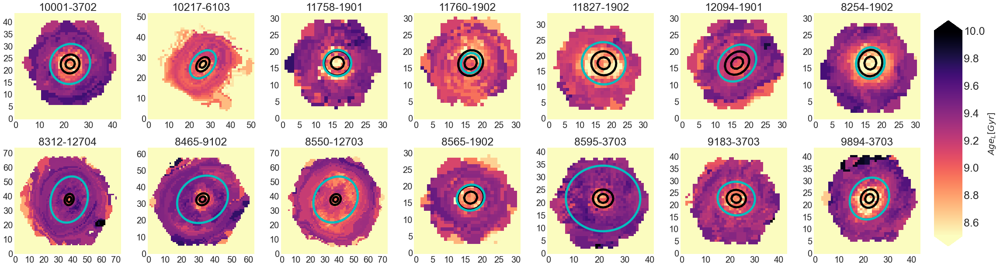

In [451]:
bbrd_fits_file_list = glob.glob("/Users/mmckay/Desktop/research/FMR_MZR/bbrd_MMfits/*.fits")

# Plot Mosaic of BBRD sample D4000 Maps from Pipe3D
fig = plt.figure(figsize=(30,9),constrained_layout=True)

#axs = [ax0,ax1,ax2,ax3,ax4,ax5,ax6,ax7,ax8,ax9,ax10,ax11,ax12,ax13]
for bbrd_fits, num in zip(np.sort(bbrd_fits_file_list), np.linspace(1,14,14)):
    hdu = fits.open(bbrd_fits)
    #print(int(num), bbrd_fits)
    AgeL_map = hdu['GYR_LW'].data
    r_reff_map = hdu['R/Reff'].data
    ellip_r_map = hdu['ELLIP R'].data
    plateifu = hdu[0].header['plateifu']
    reff = hdu[0].header['REFF']
    hdu.close()
    ax = fig.add_subplot(2,7,int(num))
    im = ax.imshow(AgeL_map, vmin=8.5, vmax=10.0, origin='lower', cmap='magma_r')

    ellip_r_contour = ax.contour(ellip_r_map, levels = np.arange(1, 3, 1), origin='lower', colors='k',
    linewidths=5)
    r_reff_contour = ax.contour(r_reff_map, levels = np.arange(1, 2, 1), origin='lower', colors='c',
    linewidths=5)
    #ax.clabel(r_reff_contour, fontsize=9, inline=1)
    ax.set_title('{}'.format(plateifu), fontsize=25)
    plt.xticks(fontsize=20)
    plt.yticks(fontsize=20)
    ax.legend(["Reff={}".format(reff)])
    


cbaxes = fig.add_axes([1, 0.1, 0.03, 0.8])
cbar = fig.colorbar(im, ax=ax, cax=cbaxes, aspect=5.3, orientation='vertical',extend='both')
cbar.ax.tick_params(labelsize=25)
cbar.set_label(label='$Age_{L}[Gyr]$', size='large', fontsize=20)
plt.tight_layout(pad=3)
plt.savefig("/Users/mmckay/Desktop/research/FMR_MZR/bbrd_MMfits/bbrd_ageL_mosaic.jpeg", bbox_inches='tight') # not displaying colorbar
plt.show()

/Users/mmckay/conda/envs/marvin_v2/lib/python3.6/site-packages/ipykernel_launcher.py:35: UserWarning:

This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.

/Users/mmckay/conda/envs/marvin_v2/lib/python3.6/site-packages/ipykernel_launcher.py:35: UserWarning:

This figure was using constrained_layout==True, but that is incompatible with subplots_adjust and or tight_layout: setting constrained_layout==False. 



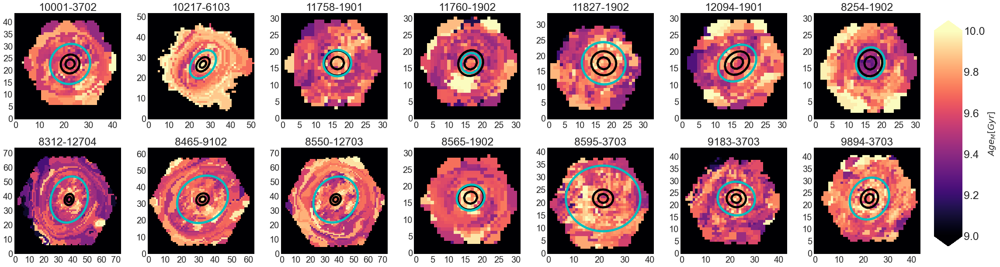

In [452]:
bbrd_fits_file_list = glob.glob("/Users/mmckay/Desktop/research/FMR_MZR/bbrd_MMfits/*.fits")

# Plot Mosaic of BBRD sample D4000 Maps from Pipe3D
fig = plt.figure(figsize=(30,9),constrained_layout=True)

#axs = [ax0,ax1,ax2,ax3,ax4,ax5,ax6,ax7,ax8,ax9,ax10,ax11,ax12,ax13]
for bbrd_fits, num in zip(np.sort(bbrd_fits_file_list), np.linspace(1,14,14)):
    hdu = fits.open(bbrd_fits)
    #print(int(num), bbrd_fits)
    AgeL_map = hdu['GYR_MW'].data
    r_reff_map = hdu['R/Reff'].data
    ellip_r_map = hdu['ELLIP R'].data
    plateifu = hdu[0].header['plateifu']
    reff = hdu[0].header['REFF']
    hdu.close()
    ax = fig.add_subplot(2,7,int(num))
    im = ax.imshow(AgeL_map, vmin=9.0, vmax=10.0, origin='lower', cmap='magma')

    ellip_r_contour = ax.contour(ellip_r_map, levels = np.arange(1, 3, 1), origin='lower', colors='k',
    linewidths=5)
    r_reff_contour = ax.contour(r_reff_map, levels = np.arange(1, 2, 1), origin='lower', colors='c',
    linewidths=5)
    #ax.clabel(r_reff_contour, fontsize=9, inline=1)
    ax.set_title('{}'.format(plateifu), fontsize=25)
    plt.xticks(fontsize=20)
    plt.yticks(fontsize=20)
    ax.legend(["Reff={}".format(reff)])
    


cbaxes = fig.add_axes([1, 0.1, 0.03, 0.8])
cbar = fig.colorbar(im, ax=ax, cax=cbaxes, aspect=5.3, orientation='vertical',extend='both')
cbar.ax.tick_params(labelsize=25)
cbar.set_label(label='$Age_{M}[Gyr]$', size='large', fontsize=20)
plt.tight_layout(pad=3)
plt.savefig("/Users/mmckay/Desktop/research/FMR_MZR/bbrd_MMfits/bbrd_ageM_mosaic.jpeg", bbox_inches='tight') # not displaying colorbar
plt.show()

/Users/mmckay/conda/envs/marvin_v2/lib/python3.6/site-packages/ipykernel_launcher.py:35: UserWarning:

This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.

/Users/mmckay/conda/envs/marvin_v2/lib/python3.6/site-packages/ipykernel_launcher.py:35: UserWarning:

This figure was using constrained_layout==True, but that is incompatible with subplots_adjust and or tight_layout: setting constrained_layout==False. 



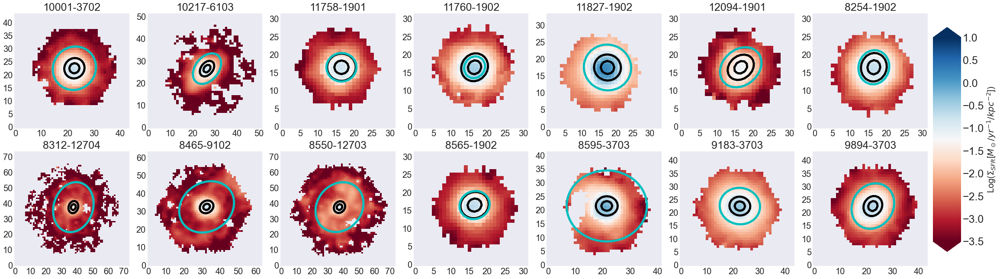

In [453]:
bbrd_fits_file_list = glob.glob("/Users/mmckay/Desktop/research/FMR_MZR/bbrd_MMfits/*.fits")

# Plot Mosaic of BBRD sample D4000 Maps from Pipe3D
fig = plt.figure(figsize=(30,9), constrained_layout=True)

#axs = [ax0,ax1,ax2,ax3,ax4,ax5,ax6,ax7,ax8,ax9,ax10,ax11,ax12,ax13]
for bbrd_fits, num in zip(np.sort(bbrd_fits_file_list), np.linspace(1,14,14)):
    hdu = fits.open(bbrd_fits)
    #print(int(num), bbrd_fits)
    logsfrd_map = hdu['LOGSFR DENSITY'].data
    r_reff_map = hdu['R/Reff'].data
    ellip_r_map = hdu['ELLIP R'].data
    plateifu = hdu[0].header['plateifu']
    reff = hdu[0].header['REFF']
    hdu.close()
    ax = fig.add_subplot(2,7,int(num))
    im = ax.imshow(logsfrd_map, vmin=-3.5, vmax=1.0, origin='lower', cmap='RdBu')

    ellip_r_contour = ax.contour(ellip_r_map, levels = np.arange(1, 3, 1), origin='lower', colors='k',
    linewidths=5)
    r_reff_contour = ax.contour(r_reff_map, levels = np.arange(1, 2, 1), origin='lower', colors='c',
    linewidths=5)
    #ax.clabel(r_reff_contour, fontsize=9, inline=1)
    ax.set_title('{}'.format(plateifu), fontsize=25)
    plt.xticks(fontsize=20)
    plt.yticks(fontsize=20)
    ax.legend(["Reff={}".format(reff)])
    


cbaxes = fig.add_axes([1, 0.1, 0.03, 0.8])
cbar = fig.colorbar(im, ax=ax, cax=cbaxes, aspect=5.3, orientation='vertical',extend='both')
cbar.ax.tick_params(labelsize=25)
cbar.set_label(label=r'Log($\Sigma_{SFR}$[$M_\odot/yr^{-1}/kpc^{-2}$])', size='large', fontsize=20)
plt.tight_layout()
plt.savefig("/Users/mmckay/Desktop/research/FMR_MZR/bbrd_MMfits/bbrd_logSFRrho_mosaic.jpeg", bbox_inches='tight') # not displaying colorbar
plt.show()

In [445]:
plt.savefig?

Signature: plt.savefig(*args, **kwargs)
Docstring:
Save the current figure.

Call signature::

  savefig(fname, dpi=None, facecolor='w', edgecolor='w',
          orientation='portrait', papertype=None, format=None,
          transparent=False, bbox_inches=None, pad_inches=0.1,
          frameon=None, metadata=None)

The available output formats depend on the backend being used.

Parameters
----------
fname : str or path-like or file-like
    A path, or a Python file-like object, or
    possibly some backend-dependent object such as
    `matplotlib.backends.backend_pdf.PdfPages`.

    If *format* is set, it determines the output format, and the file
    is saved as *fname*.  Note that *fname* is used verbatim, and there
    is no attempt to make the extension, if any, of *fname* match
    *format*, and no extension is appended.

    If *format* is not set, then the format is inferred from the
    extension of *fname*, if there is one.  If *format* is not
    set and *fname* has no exten

# BBRD radial profiles

/Users/mmckay/conda/envs/marvin_v2/lib/python3.6/site-packages/ipykernel_launcher.py:56: UserWarning:

This figure was using constrained_layout==True, but that is incompatible with subplots_adjust and or tight_layout: setting constrained_layout==False. 



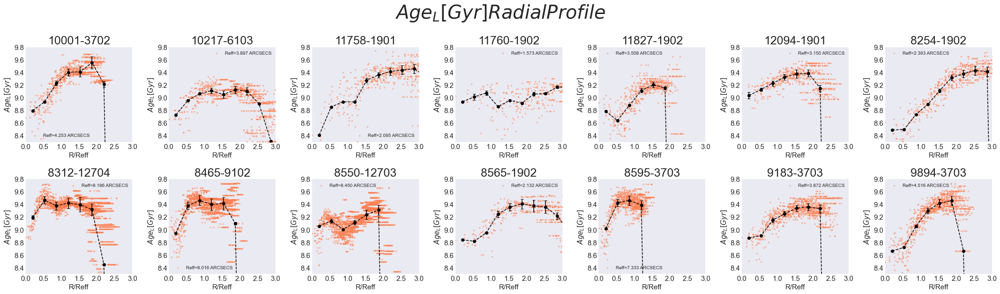

In [514]:
bbrd_fits_file_list = glob.glob("/Users/mmckay/Desktop/research/FMR_MZR/bbrd_MMfits/*.fits")
bbrd_csv_file_list = glob.glob("/Users/mmckay/Desktop/research/FMR_MZR/bbrd_MMfits/*.csv")

# Plot Mosaic of BBRD sample D4000 Maps from Pipe3D
fig = plt.figure(figsize=(30,9), constrained_layout=True)

#axs = [ax0,ax1,ax2,ax3,ax4,ax5,ax6,ax7,ax8,ax9,ax10,ax11,ax12,ax13]
for bbrd_fits, bbrd_csv, num in zip(np.sort(bbrd_fits_file_list), np.sort(bbrd_csv_file_list), np.linspace(1,14,14)):
    # Read in FITS data
    hdu = fits.open(bbrd_fits)
    #print(int(num), bbrd_fits, bbrd_csv)
    # ageL_map = hdu['GYR_LW'].data
    # ageL_err_map = hdu['GYR_ERR'].data
    # r_reff_map = hdu['R/Reff'].data
    # # ellip_r_map = hdu['ELLIP R'].data
    plateifu = hdu[0].header['plateifu']
    reff = hdu[0].header['REFF']

    # Read in CSV data
    df = pd.read_csv(bbrd_csv)
    xdata = df['R/REFF']
    ydata = df['GYR_LW']
    yerr = df['GYR_ERR']

    # split data in radial bins and 
    bins = np.linspace(0, 5, 16)
    digitized = np.digitize(xdata, bins)

    # Calulates the median of each bin
    bin_meds = [xdata[digitized == i].median() for i in range(1, len(bins))]
    agel_bin_meds = [ydata[digitized == i].median() for i in range(1, len(bins))]
    agel_bin_stds = [ydata[digitized == i].std() for i in range(1, len(bins))]
    agel_err_bin_meds = [yerr[digitized == i].median() for i in range(1, len(bins))]

    # set xaxis for bin medians
    x = bins[:len(bin_meds)] + .2 # adjust for display offset


    # Plotting
    ax = fig.add_subplot(2,7,int(num))
    ax.scatter(xdata, ydata, s=6, marker='x', alpha=0.5, color='coral')
    ax.scatter(x, agel_bin_meds, alpha=1.0, color='black')
    #ax.plot(x, agel_bin_meds, alpha=1.0, color='black')
    #ax.errorbar(x, agel_bin_meds, yerr=1/(np.array(agel_bin_stds)**2), color='cyan')
    ax.errorbar(x, agel_bin_meds, yerr=agel_err_bin_meds, color='black', linestyle='--', capsize=3)
    ax.set_ylim(8.3, 9.8)
    ax.set_xlim(0, 3)
    ax.set_xlabel('R/Reff', fontsize=15)
    ax.set_ylabel('$Age_{L}[Gyr]$', fontsize=15)
    ax.set_title('{}'.format(plateifu), fontsize=25)
    plt.xticks(fontsize=15)
    plt.yticks(fontsize=15)
    ax.legend(["Reff={}".format(reff)])

plt.suptitle('$Age_{L}[Gyr] Radial Profile$', fontsize=40) 
plt.tight_layout(pad=2)
plt.savefig("/Users/mmckay/Desktop/research/FMR_MZR/bbrd_MMfits/bbrd_ageL_radpro.jpeg") # not displaying colorbar
plt.show()

/Users/mmckay/conda/envs/marvin_v2/lib/python3.6/site-packages/ipykernel_launcher.py:56: UserWarning:

This figure was using constrained_layout==True, but that is incompatible with subplots_adjust and or tight_layout: setting constrained_layout==False. 



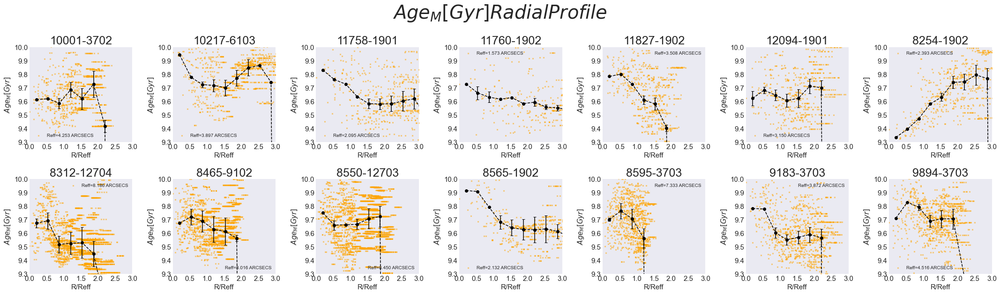

In [423]:
bbrd_fits_file_list = glob.glob("/Users/mmckay/Desktop/research/FMR_MZR/bbrd_MMfits/*.fits")
bbrd_csv_file_list = glob.glob("/Users/mmckay/Desktop/research/FMR_MZR/bbrd_MMfits/*.csv")

# Plot Mosaic of BBRD sample D4000 Maps from Pipe3D
fig = plt.figure(figsize=(30,9), constrained_layout=True)

#axs = [ax0,ax1,ax2,ax3,ax4,ax5,ax6,ax7,ax8,ax9,ax10,ax11,ax12,ax13]
for bbrd_fits, bbrd_csv, num in zip(np.sort(bbrd_fits_file_list), np.sort(bbrd_csv_file_list), np.linspace(1,14,14)):
    # Read in FITS data
    hdu = fits.open(bbrd_fits)
    #print(int(num), bbrd_fits, bbrd_csv)
    # ageL_map = hdu['GYR_LW'].data
    # ageL_err_map = hdu['GYR_ERR'].data
    # r_reff_map = hdu['R/Reff'].data
    # # ellip_r_map = hdu['ELLIP R'].data
    plateifu = hdu[0].header['plateifu']
    reff = hdu[0].header['REFF']

    # Read in CSV data
    df = pd.read_csv(bbrd_csv)
    xdata = df['R/REFF']
    ydata = df['GYR_MW']
    yerr = df['GYR_ERR']

    # split data in radial bins and 
    bins = np.linspace(0, 5, 16)
    digitized = np.digitize(xdata, bins)

    # Calulates the median of each bin
    bin_meds = [xdata[digitized == i].median() for i in range(1, len(bins))]
    agel_bin_meds = [ydata[digitized == i].median() for i in range(1, len(bins))]
    agel_bin_stds = [ydata[digitized == i].std() for i in range(1, len(bins))]
    agel_err_bin_meds = [yerr[digitized == i].median() for i in range(1, len(bins))]

    # set xaxis for bin medians
    x = bins[:len(bin_meds)] + .2 # adjust for display offset


    # Plotting
    ax = fig.add_subplot(2,7,int(num))
    ax.scatter(xdata, ydata, s=6, marker='x', alpha=0.5, color='orange')
    ax.scatter(x, agel_bin_meds, alpha=1.0, color='black')
    #ax.plot(x, agel_bin_meds, alpha=1.0, color='black')
    #ax.errorbar(x, agel_bin_meds, yerr=1/(np.array(agel_bin_stds)**2), color='cyan')
    ax.errorbar(x, agel_bin_meds, yerr=agel_err_bin_meds, color='black', linestyle='--', capsize=3)
    ax.set_ylim(9.3, 10)
    ax.set_xlim(0, 3)
    ax.set_xlabel('R/Reff', fontsize=15)
    ax.set_ylabel('$Age_{M}[Gyr]$', fontsize=15)
    ax.set_title('{}'.format(plateifu), fontsize=25)
    plt.xticks(fontsize=15)
    plt.yticks(fontsize=15)
    ax.legend(["Reff={}".format(reff)])

plt.suptitle(r'$Age_{M}[Gyr] Radial Profile$', fontsize=40)  
plt.tight_layout(pad=2)
plt.savefig("/Users/mmckay/Desktop/research/FMR_MZR/bbrd_MMfits/bbrd_ageM_radpro.jpeg") # not displaying colorbar
plt.show()

/Users/mmckay/conda/envs/marvin_v2/lib/python3.6/site-packages/ipykernel_launcher.py:57: UserWarning:

This figure was using constrained_layout==True, but that is incompatible with subplots_adjust and or tight_layout: setting constrained_layout==False. 



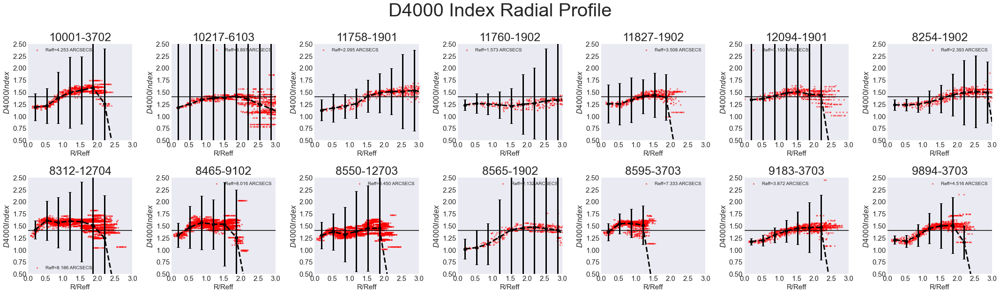

In [455]:
bbrd_fits_file_list = glob.glob("/Users/mmckay/Desktop/research/FMR_MZR/bbrd_MMfits/*.fits")
bbrd_csv_file_list = glob.glob("/Users/mmckay/Desktop/research/FMR_MZR/bbrd_MMfits/*.csv")

# Plot Mosaic of BBRD sample D4000 Maps from Pipe3D
fig = plt.figure(figsize=(30,9), constrained_layout=True)

#axs = [ax0,ax1,ax2,ax3,ax4,ax5,ax6,ax7,ax8,ax9,ax10,ax11,ax12,ax13]
for bbrd_fits, bbrd_csv, num in zip(np.sort(bbrd_fits_file_list), np.sort(bbrd_csv_file_list), np.linspace(1,14,14)):
    # Read in FITS data
    hdu = fits.open(bbrd_fits)
    #print(int(num), bbrd_fits, bbrd_csv)
    # ageL_map = hdu['GYR_LW'].data
    # ageL_err_map = hdu['GYR_ERR'].data
    # r_reff_map = hdu['R/Reff'].data
    # # ellip_r_map = hdu['ELLIP R'].data
    plateifu = hdu[0].header['plateifu']
    reff = hdu[0].header['REFF']

    # Read in CSV data
    df = pd.read_csv(bbrd_csv)
    xdata = df['R/REFF']
    ydata = df['D4000']
    yerr = df['D4000_ERR']

    # split data in radial bins and 
    bins = np.linspace(0, 5, 16)
    digitized = np.digitize(xdata, bins)

    # Calulates the median of each bin
    bin_meds = [xdata[digitized == i].median() for i in range(1, len(bins))]
    agel_bin_meds = [ydata[digitized == i].median() for i in range(1, len(bins))]
    agel_bin_stds = [ydata[digitized == i].std() for i in range(1, len(bins))]
    agel_err_bin_meds = [yerr[digitized == i].median() for i in range(1, len(bins))]

    # set xaxis for bin medians
    x = bins[:len(bin_meds)] + .2 # adjust for display offset


    # Plotting
    ax = fig.add_subplot(2,7,int(num))
    ax.scatter(xdata, ydata, s=6, marker='x', alpha=0.5, color='red')
    ax.scatter(x, agel_bin_meds, alpha=1.0, color='black')
    #ax.plot(x, agel_bin_meds, alpha=1.0, color='black')
    #ax.errorbar(x, agel_bin_meds, yerr=1/(np.array(agel_bin_stds)**2), color='cyan')
    ax.errorbar(x, agel_bin_meds, yerr=agel_err_bin_meds, color='black', linestyle='--', capsize=3, linewidth=3.0)
    ax.set_ylim(0.5, 2.5)
    ax.set_xlim(0, 3)
    ax.set_xlabel('R/Reff', fontsize=15)
    ax.set_ylabel('$D4000 Index$', fontsize=15)
    ax.set_title('{}'.format(plateifu), fontsize=25)
    plt.xticks(fontsize=15)
    plt.yticks(fontsize=15)
    ax.legend(["Reff={}".format(reff)])
    ax.axhline(1.4, color='black')

plt.suptitle('D4000 Index Radial Profile', fontsize=40)  
plt.tight_layout(pad=2)
plt.savefig("/Users/mmckay/Desktop/research/FMR_MZR/bbrd_MMfits/bbrd_d4000_radpro.jpeg") # not displaying colorbar
plt.show()

/Users/mmckay/conda/envs/marvin_v2/lib/python3.6/site-packages/ipykernel_launcher.py:58: UserWarning:

This figure was using constrained_layout==True, but that is incompatible with subplots_adjust and or tight_layout: setting constrained_layout==False. 



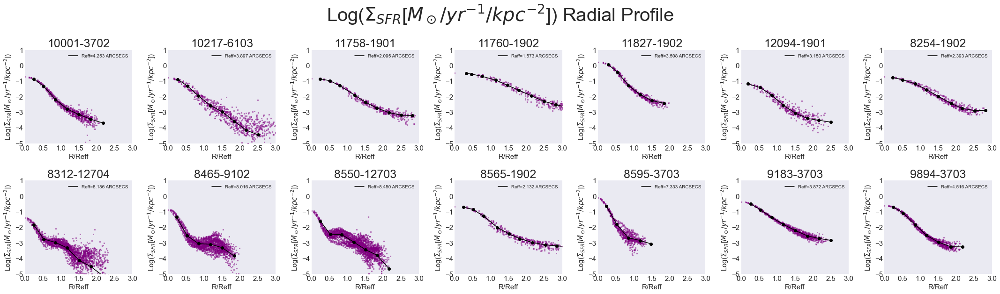

In [480]:
bbrd_fits_file_list = glob.glob("/Users/mmckay/Desktop/research/FMR_MZR/bbrd_MMfits/*.fits")
bbrd_csv_file_list = glob.glob("/Users/mmckay/Desktop/research/FMR_MZR/bbrd_MMfits/*.csv")

# Plot Mosaic of BBRD sample D4000 Maps from Pipe3D
fig = plt.figure(figsize=(30,9), constrained_layout=True)

#axs = [ax0,ax1,ax2,ax3,ax4,ax5,ax6,ax7,ax8,ax9,ax10,ax11,ax12,ax13]
for bbrd_fits, bbrd_csv, num in zip(np.sort(bbrd_fits_file_list), np.sort(bbrd_csv_file_list), np.linspace(1,14,14)):
    # Read in FITS data
    hdu = fits.open(bbrd_fits)
    #print(int(num), bbrd_fits, bbrd_csv)
    # ageL_map = hdu['GYR_LW'].data
    # ageL_err_map = hdu['GYR_ERR'].data
    # r_reff_map = hdu['R/Reff'].data
    # # ellip_r_map = hdu['ELLIP R'].data
    plateifu = hdu[0].header['plateifu']
    reff = hdu[0].header['REFF']

    # Read in CSV data
    df = pd.read_csv(bbrd_csv)
    xdata = df['R/REFF']
    ydata = df['LOGSFR DENSITY']
    #yerr = df['D4000_ERR']

    # split data in radial bins and 
    bins = np.linspace(0, 5, 16)
    digitized = np.digitize(xdata, bins)

    # Calulates the median of each bin
    xdata_bin_meds = [xdata[digitized == i].median() for i in range(1, len(bins))]
    ydata_bin_meds = [ydata[digitized == i].median() for i in range(1, len(bins))]
    ydata_bin_stds = [ydata[digitized == i].std() for i in range(1, len(bins))]
    #yerr_bin_meds = [yerr[digitized == i].median() for i in range(1, len(bins))]

    # set xaxis for bin medians
    x = bins[:len(xdata_bin_meds)] + .2 # adjust for display offset


    # Plotting
    ax = fig.add_subplot(2,7,int(num))
    ax.scatter(xdata, ydata, s=6, marker='x', alpha=0.5, color='purple')
    ax.scatter(xdata_bin_meds, ydata_bin_meds, alpha=1.0, color='black')
    ax.plot(xdata_bin_meds, ydata_bin_meds, alpha=1.0, color='black')
    #ax.plot(x, agel_bin_meds, alpha=1.0, color='black')
    #ax.errorbar(x, agel_bin_meds, yerr=1/(np.array(agel_bin_stds)**2), color='cyan')
    #ax.errorbar(x, ydata_bin_meds, yerr=yerr_bin_meds, color='black', linestyle='--', capsize=3, linewidth=3.0)
    ax.set_ylim(-5, 1)
    ax.set_xlim(0, 3)
    ax.set_xlabel('R/Reff', fontsize=15)
    ax.set_ylabel(r'Log($\Sigma_{SFR}$[$M_\odot/yr^{-1}/kpc^{-2}$])', fontsize=15)
    ax.set_title('{}'.format(plateifu), fontsize=25)
    plt.xticks(fontsize=15)
    plt.yticks(fontsize=15)
    ax.legend(["Reff={}".format(reff)])
    #ax.axhline(1.4, color='black')

plt.suptitle(r'Log($\Sigma_{SFR}$[$M_\odot/yr^{-1}/kpc^{-2}$]) Radial Profile', fontsize=40)  
plt.tight_layout(pad=2)
plt.savefig("/Users/mmckay/Desktop/research/FMR_MZR/bbrd_MMfits/bbrd_logSFRrho_radpro.jpeg") # not displaying colorbar
plt.show()

/Users/mmckay/conda/envs/marvin_v2/lib/python3.6/site-packages/numpy/lib/nanfunctions.py:1111: RuntimeWarning:

Mean of empty slice

/Users/mmckay/conda/envs/marvin_v2/lib/python3.6/site-packages/ipykernel_launcher.py:58: UserWarning:

This figure was using constrained_layout==True, but that is incompatible with subplots_adjust and or tight_layout: setting constrained_layout==False. 



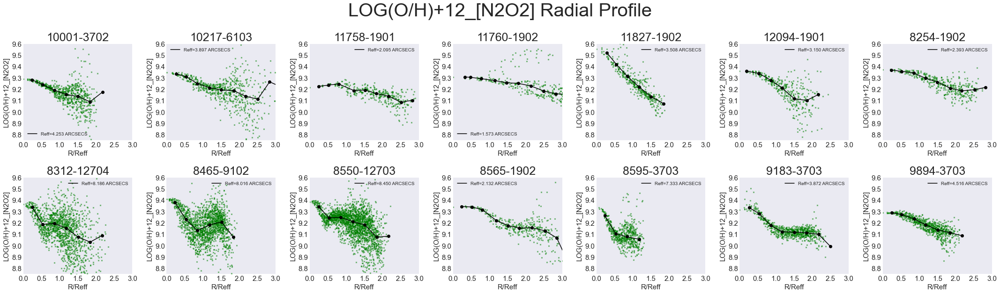

In [470]:
bbrd_fits_file_list = glob.glob("/Users/mmckay/Desktop/research/FMR_MZR/bbrd_MMfits/*.fits")
bbrd_csv_file_list = glob.glob("/Users/mmckay/Desktop/research/FMR_MZR/bbrd_MMfits/*.csv")

# Plot Mosaic of BBRD sample D4000 Maps from Pipe3D
fig = plt.figure(figsize=(30,9), constrained_layout=True)

#axs = [ax0,ax1,ax2,ax3,ax4,ax5,ax6,ax7,ax8,ax9,ax10,ax11,ax12,ax13]
for bbrd_fits, bbrd_csv, num in zip(np.sort(bbrd_fits_file_list), np.sort(bbrd_csv_file_list), np.linspace(1,14,14)):
    # Read in FITS data
    hdu = fits.open(bbrd_fits)
    #print(int(num), bbrd_fits, bbrd_csv)
    # ageL_map = hdu['GYR_LW'].data
    # ageL_err_map = hdu['GYR_ERR'].data
    # r_reff_map = hdu['R/Reff'].data
    # # ellip_r_map = hdu['ELLIP R'].data
    plateifu = hdu[0].header['plateifu']
    reff = hdu[0].header['REFF']

    # Read in CSV data
    df = pd.read_csv(bbrd_csv)
    xdata = df['R/REFF']
    ydata = df['LOG(O/H)+12_[N2O2]']
    #yerr = df['D4000_ERR']

    # split data in radial bins and 
    bins = np.linspace(0, 5, 16)
    digitized = np.digitize(xdata, bins)

    # Calulates the median of each bin
    xdata_bin_meds = [xdata[digitized == i].median() for i in range(1, len(bins))]
    ydata_bin_meds = [ydata[digitized == i].median() for i in range(1, len(bins))]
    ydata_bin_stds = [ydata[digitized == i].std() for i in range(1, len(bins))]
    #yerr_bin_meds = [yerr[digitized == i].median() for i in range(1, len(bins))]

    # set xaxis for bin medians
    x = bins[:len(xdata_bin_meds)] + .2 # adjust for display offset


    # Plotting
    ax = fig.add_subplot(2,7,int(num))
    ax.scatter(xdata, ydata, s=6, marker='x', alpha=0.5, color='green')
    ax.scatter(xdata_bin_meds, ydata_bin_meds, alpha=1.0, color='black')
    ax.plot(xdata_bin_meds, ydata_bin_meds, alpha=1.0, color='black')
    #ax.plot(x, agel_bin_meds, alpha=1.0, color='black')
    #ax.errorbar(x, agel_bin_meds, yerr=1/(np.array(agel_bin_stds)**2), color='cyan')
    #ax.errorbar(x, ydata_bin_meds, yerr=yerr_bin_meds, color='black', linestyle='--', capsize=3, linewidth=3.0)
    ax.set_ylim(8.75, 9.6)
    ax.set_xlim(0, 3)
    ax.set_xlabel('R/Reff', fontsize=15)
    ax.set_ylabel('LOG(O/H)+12_[N2O2]', fontsize=15)
    ax.set_title('{}'.format(plateifu), fontsize=25)
    plt.xticks(fontsize=15)
    plt.yticks(fontsize=15)
    ax.legend(["Reff={}".format(reff)])
    #ax.axhline(1.4, color='black')

plt.suptitle('LOG(O/H)+12_[N2O2] Radial Profile', fontsize=40)  
plt.tight_layout(pad=2)
plt.savefig("/Users/mmckay/Desktop/research/FMR_MZR/bbrd_MMfits/bbrd_metaln2o2_radpro.jpeg") # not displaying colorbar
plt.show()

/Users/mmckay/conda/envs/marvin_v2/lib/python3.6/site-packages/numpy/lib/nanfunctions.py:1111: RuntimeWarning:

Mean of empty slice

/Users/mmckay/conda/envs/marvin_v2/lib/python3.6/site-packages/ipykernel_launcher.py:58: UserWarning:

This figure was using constrained_layout==True, but that is incompatible with subplots_adjust and or tight_layout: setting constrained_layout==False. 



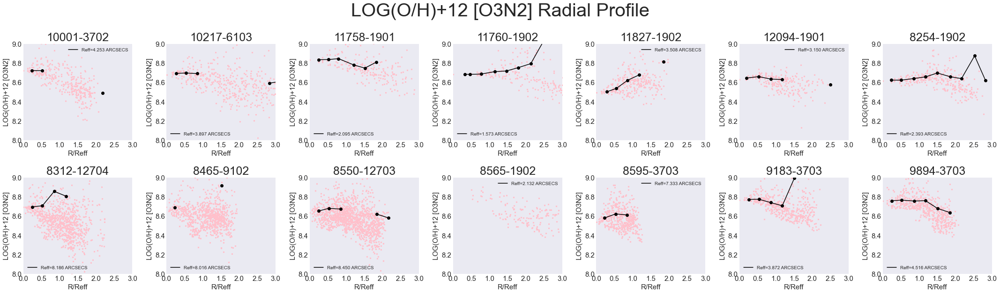

In [479]:
bbrd_fits_file_list = glob.glob("/Users/mmckay/Desktop/research/FMR_MZR/bbrd_MMfits/*.fits")
bbrd_csv_file_list = glob.glob("/Users/mmckay/Desktop/research/FMR_MZR/bbrd_MMfits/*.csv")

# Plot Mosaic of BBRD sample D4000 Maps from Pipe3D
fig = plt.figure(figsize=(30,9), constrained_layout=True)

#axs = [ax0,ax1,ax2,ax3,ax4,ax5,ax6,ax7,ax8,ax9,ax10,ax11,ax12,ax13]
for bbrd_fits, bbrd_csv, num in zip(np.sort(bbrd_fits_file_list), np.sort(bbrd_csv_file_list), np.linspace(1,14,14)):
    # Read in FITS data
    hdu = fits.open(bbrd_fits)
    #print(int(num), bbrd_fits, bbrd_csv)
    # ageL_map = hdu['GYR_LW'].data
    # ageL_err_map = hdu['GYR_ERR'].data
    # r_reff_map = hdu['R/Reff'].data
    # # ellip_r_map = hdu['ELLIP R'].data
    plateifu = hdu[0].header['plateifu']
    reff = hdu[0].header['REFF']

    # Read in CSV data
    df = pd.read_csv(bbrd_csv)
    xdata = df['R/REFF']
    ydata = df['LOG(O/H)+12_[O3N2]']
    #yerr = df['D4000_ERR']

    # split data in radial bins and 
    bins = np.linspace(0, 5, 16)
    digitized = np.digitize(xdata, bins)

    # Calulates the median of each bin
    xdata_bin_meds = [xdata[digitized == i].median() for i in range(1, len(bins))]
    ydata_bin_meds = [ydata[digitized == i].median() for i in range(1, len(bins))]
    ydata_bin_stds = [ydata[digitized == i].std() for i in range(1, len(bins))]
    #yerr_bin_meds = [yerr[digitized == i].median() for i in range(1, len(bins))]

    # set xaxis for bin medians
    x = bins[:len(xdata_bin_meds)] + .2 # adjust for display offset


    # Plotting
    ax = fig.add_subplot(2,7,int(num))
    ax.scatter(xdata, ydata, s=6, marker='x', alpha=1.0, color='pink')
    ax.scatter(xdata_bin_meds, ydata_bin_meds, alpha=1.0, color='black')
    ax.plot(xdata_bin_meds, ydata_bin_meds, alpha=1.0, color='black')
    #ax.plot(x, agel_bin_meds, alpha=1.0, color='black')
    #ax.errorbar(x, agel_bin_meds, yerr=1/(np.array(agel_bin_stds)**2), color='cyan')
    #ax.errorbar(x, ydata_bin_meds, yerr=yerr_bin_meds, color='black', linestyle='--', capsize=3, linewidth=3.0)
    ax.set_ylim(8, 9.0)
    ax.set_xlim(0, 3)
    ax.set_xlabel('R/Reff', fontsize=15)
    ax.set_ylabel('LOG(O/H)+12 [O3N2]', fontsize=15)
    ax.set_title('{}'.format(plateifu), fontsize=25)
    plt.xticks(fontsize=15)
    plt.yticks(fontsize=15)
    ax.legend(["Reff={}".format(reff)])
    #ax.axhline(1.4, color='black')

plt.suptitle('LOG(O/H)+12 [O3N2] Radial Profile', fontsize=40)  
plt.tight_layout(pad=2)
plt.savefig("/Users/mmckay/Desktop/research/FMR_MZR/bbrd_MMfits/bbrd_metalo3n2_radpro.jpeg") # not displaying colorbar
plt.show()

/Users/mmckay/conda/envs/marvin_v2/lib/python3.6/site-packages/numpy/lib/nanfunctions.py:1111: RuntimeWarning:

Mean of empty slice

/Users/mmckay/conda/envs/marvin_v2/lib/python3.6/site-packages/ipykernel_launcher.py:58: UserWarning:

This figure was using constrained_layout==True, but that is incompatible with subplots_adjust and or tight_layout: setting constrained_layout==False. 



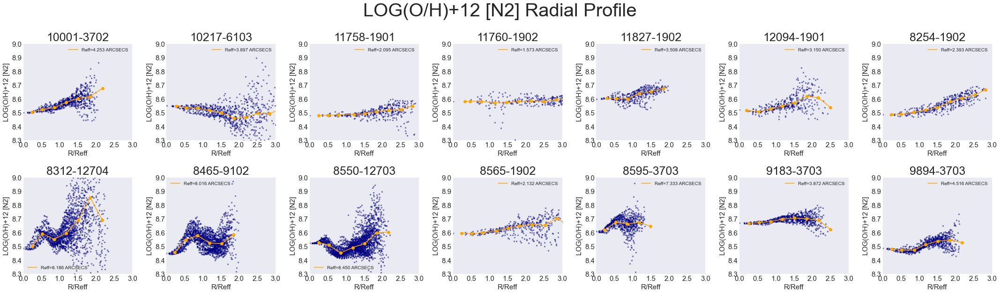

In [488]:
bbrd_fits_file_list = glob.glob("/Users/mmckay/Desktop/research/FMR_MZR/bbrd_MMfits/*.fits")
bbrd_csv_file_list = glob.glob("/Users/mmckay/Desktop/research/FMR_MZR/bbrd_MMfits/*.csv")

# Plot Mosaic of BBRD sample D4000 Maps from Pipe3D
fig = plt.figure(figsize=(30,9), constrained_layout=True)

#axs = [ax0,ax1,ax2,ax3,ax4,ax5,ax6,ax7,ax8,ax9,ax10,ax11,ax12,ax13]
for bbrd_fits, bbrd_csv, num in zip(np.sort(bbrd_fits_file_list), np.sort(bbrd_csv_file_list), np.linspace(1,14,14)):
    # Read in FITS data
    hdu = fits.open(bbrd_fits)
    #print(int(num), bbrd_fits, bbrd_csv)
    # ageL_map = hdu['GYR_LW'].data
    # ageL_err_map = hdu['GYR_ERR'].data
    # r_reff_map = hdu['R/Reff'].data
    # # ellip_r_map = hdu['ELLIP R'].data
    plateifu = hdu[0].header['plateifu']
    reff = hdu[0].header['REFF']

    # Read in CSV data
    df = pd.read_csv(bbrd_csv)
    xdata = df['R/REFF']
    ydata = df['LOG(O/H)+12_[N2]']
    #yerr = df['D4000_ERR']

    # split data in radial bins and 
    bins = np.linspace(0, 5, 16)
    digitized = np.digitize(xdata, bins)

    # Calulates the median of each bin
    xdata_bin_meds = [xdata[digitized == i].median() for i in range(1, len(bins))]
    ydata_bin_meds = [ydata[digitized == i].median() for i in range(1, len(bins))]
    ydata_bin_stds = [ydata[digitized == i].std() for i in range(1, len(bins))]
    #yerr_bin_meds = [yerr[digitized == i].median() for i in range(1, len(bins))]

    # set xaxis for bin medians
    #x = bins[:len(xdata_bin_meds)] + .2 # adjust for display offset


    # Plotting
    ax = fig.add_subplot(2,7,int(num))
    ax.scatter(xdata, ydata, s=6, marker='x', alpha=0.5, color='navy')
    ax.scatter(xdata_bin_meds, ydata_bin_meds, alpha=1.0, color='orange')
    ax.plot(xdata_bin_meds, ydata_bin_meds, alpha=1.0, color='orange')
    #ax.plot(x, agel_bin_meds, alpha=1.0, color='black')
    #ax.errorbar(x, agel_bin_meds, yerr=1/(np.array(agel_bin_stds)**2), color='cyan')
    #ax.errorbar(x, ydata_bin_meds, yerr=yerr_bin_meds, color='black', linestyle='--', capsize=3, linewidth=3.0)
    ax.set_ylim(8.3, 9.0)
    ax.set_xlim(0, 3)
    ax.set_xlabel('R/Reff', fontsize=15)
    ax.set_ylabel('LOG(O/H)+12 [N2]', fontsize=15)
    ax.set_title('{}'.format(plateifu), fontsize=25)
    plt.xticks(fontsize=15)
    plt.yticks(fontsize=15)
    ax.legend(["Reff={}".format(reff)])
    #ax.axhline(1.4, color='black')

plt.suptitle('LOG(O/H)+12 [N2] Radial Profile', fontsize=40)  
plt.tight_layout(pad=2)
plt.savefig("/Users/mmckay/Desktop/research/FMR_MZR/bbrd_MMfits/bbrd_metaln2_radpro.jpeg") # not displaying colorbar
plt.show()

# Mass-Metallicity Relation plots for BBRD sample

/Users/mmckay/conda/envs/marvin_v2/lib/python3.6/site-packages/ipykernel_launcher.py:58: UserWarning:

This figure was using constrained_layout==True, but that is incompatible with subplots_adjust and or tight_layout: setting constrained_layout==False. 



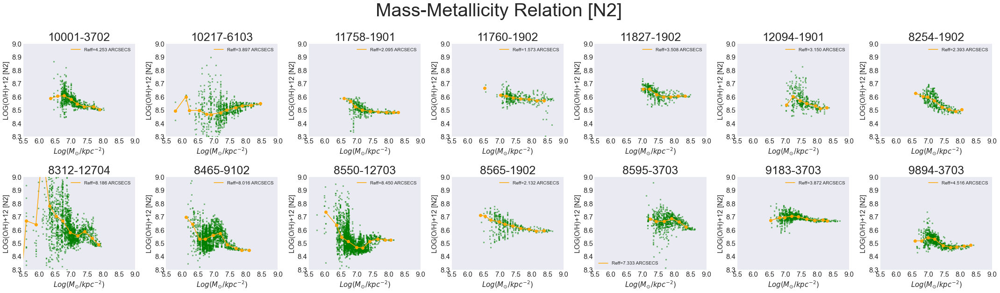

In [496]:
bbrd_fits_file_list = glob.glob("/Users/mmckay/Desktop/research/FMR_MZR/bbrd_MMfits/*.fits")
bbrd_csv_file_list = glob.glob("/Users/mmckay/Desktop/research/FMR_MZR/bbrd_MMfits/*.csv")

# Plot Mosaic of BBRD sample D4000 Maps from Pipe3D
fig = plt.figure(figsize=(30,9), constrained_layout=True)

#axs = [ax0,ax1,ax2,ax3,ax4,ax5,ax6,ax7,ax8,ax9,ax10,ax11,ax12,ax13]
for bbrd_fits, bbrd_csv, num in zip(np.sort(bbrd_fits_file_list), np.sort(bbrd_csv_file_list), np.linspace(1,14,14)):
    # Read in FITS data
    hdu = fits.open(bbrd_fits)
    #print(int(num), bbrd_fits, bbrd_csv)
    # ageL_map = hdu['GYR_LW'].data
    # ageL_err_map = hdu['GYR_ERR'].data
    # r_reff_map = hdu['R/Reff'].data
    # # ellip_r_map = hdu['ELLIP R'].data
    plateifu = hdu[0].header['plateifu']
    reff = hdu[0].header['REFF']

    # Read in CSV data
    df = pd.read_csv(bbrd_csv)
    xdata = df['MSUN/SPX2']
    ydata = df['LOG(O/H)+12_[N2]']
    #yerr = df['D4000_ERR']

    # split data in radial bins and 
    bins = np.linspace(5, 8.5, 16)
    digitized = np.digitize(xdata, bins)

    # Calulates the median of each bin
    xdata_bin_meds = [xdata[digitized == i].median() for i in range(1, len(bins))]
    ydata_bin_meds = [ydata[digitized == i].median() for i in range(1, len(bins))]
    ydata_bin_stds = [ydata[digitized == i].std() for i in range(1, len(bins))]
    #yerr_bin_meds = [yerr[digitized == i].median() for i in range(1, len(bins))]

    # set xaxis for bin medians
    #x = bins[:len(xdata_bin_meds)] + .2 # adjust for display offset


    # Plotting
    ax = fig.add_subplot(2,7,int(num))
    ax.scatter(xdata, ydata, s=6, marker='x', alpha=0.5, color='green')
    ax.scatter(xdata_bin_meds, ydata_bin_meds, alpha=1.0, color='orange')
    ax.plot(xdata_bin_meds, ydata_bin_meds, alpha=1.0, color='orange')
    #ax.plot(x, agel_bin_meds, alpha=1.0, color='black')
    #ax.errorbar(x, agel_bin_meds, yerr=1/(np.array(agel_bin_stds)**2), color='cyan')
    #ax.errorbar(x, ydata_bin_meds, yerr=yerr_bin_meds, color='black', linestyle='--', capsize=3, linewidth=3.0)
    ax.set_ylim(8.3, 9.0)
    ax.set_xlim(5.5, 9)
    ax.set_xlabel(r'$Log(M_{\odot}/kpc^{-2})$', fontsize=15)
    ax.set_ylabel('LOG(O/H)+12 [N2]', fontsize=15)
    ax.set_title('{}'.format(plateifu), fontsize=25)
    plt.xticks(fontsize=15)
    plt.yticks(fontsize=15)
    ax.legend(["Reff={}".format(reff)])
    #ax.axhline(1.4, color='black')

plt.suptitle('Mass-Metallicity Relation [N2]', fontsize=40)  
plt.tight_layout(pad=2)
plt.savefig("/Users/mmckay/Desktop/research/FMR_MZR/bbrd_MMfits/bbrd_MZRn2_radpro.jpeg") # not displaying colorbar
plt.show()

/Users/mmckay/conda/envs/marvin_v2/lib/python3.6/site-packages/ipykernel_launcher.py:58: UserWarning:

This figure was using constrained_layout==True, but that is incompatible with subplots_adjust and or tight_layout: setting constrained_layout==False. 



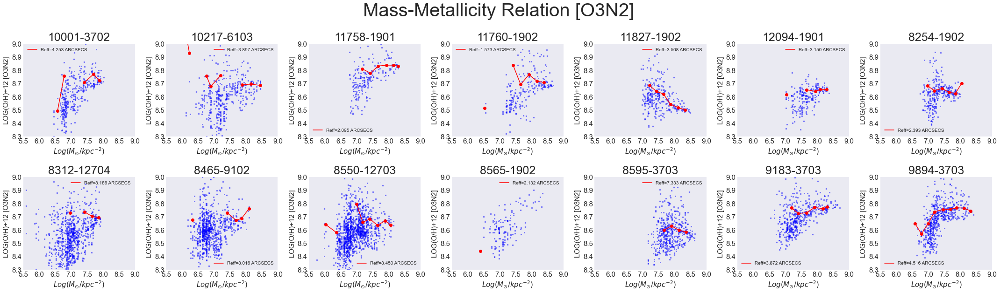

In [502]:
bbrd_fits_file_list = glob.glob("/Users/mmckay/Desktop/research/FMR_MZR/bbrd_MMfits/*.fits")
bbrd_csv_file_list = glob.glob("/Users/mmckay/Desktop/research/FMR_MZR/bbrd_MMfits/*.csv")

# Plot Mosaic of BBRD sample D4000 Maps from Pipe3D
fig = plt.figure(figsize=(30,9), constrained_layout=True)

#axs = [ax0,ax1,ax2,ax3,ax4,ax5,ax6,ax7,ax8,ax9,ax10,ax11,ax12,ax13]
for bbrd_fits, bbrd_csv, num in zip(np.sort(bbrd_fits_file_list), np.sort(bbrd_csv_file_list), np.linspace(1,14,14)):
    # Read in FITS data
    hdu = fits.open(bbrd_fits)
    #print(int(num), bbrd_fits, bbrd_csv)
    # ageL_map = hdu['GYR_LW'].data
    # ageL_err_map = hdu['GYR_ERR'].data
    # r_reff_map = hdu['R/Reff'].data
    # # ellip_r_map = hdu['ELLIP R'].data
    plateifu = hdu[0].header['plateifu']
    reff = hdu[0].header['REFF']

    # Read in CSV data
    df = pd.read_csv(bbrd_csv)
    xdata = df['MSUN/SPX2']
    ydata = df['LOG(O/H)+12_[O3N2]']
    #yerr = df['D4000_ERR']

    # split data in radial bins and 
    bins = np.linspace(5, 8.5, 16)
    digitized = np.digitize(xdata, bins)

    # Calulates the median of each bin
    xdata_bin_meds = [xdata[digitized == i].median() for i in range(1, len(bins))]
    ydata_bin_meds = [ydata[digitized == i].median() for i in range(1, len(bins))]
    ydata_bin_stds = [ydata[digitized == i].std() for i in range(1, len(bins))]
    #yerr_bin_meds = [yerr[digitized == i].median() for i in range(1, len(bins))]

    # set xaxis for bin medians
    #x = bins[:len(xdata_bin_meds)] + .2 # adjust for display offset


    # Plotting
    ax = fig.add_subplot(2,7,int(num))
    ax.scatter(xdata, ydata, s=6, marker='x', alpha=0.5, color='blue')
    ax.scatter(xdata_bin_meds, ydata_bin_meds, alpha=1.0, color='red')
    ax.plot(xdata_bin_meds, ydata_bin_meds, alpha=1.0, color='red')
    #ax.plot(x, agel_bin_meds, alpha=1.0, color='black')
    #ax.errorbar(x, agel_bin_meds, yerr=1/(np.array(agel_bin_stds)**2), color='cyan')
    #ax.errorbar(x, ydata_bin_meds, yerr=yerr_bin_meds, color='black', linestyle='--', capsize=3, linewidth=3.0)
    ax.set_ylim(8.3, 9.0)
    ax.set_xlim(5.5, 9)
    ax.set_xlabel(r'$Log(M_{\odot}/kpc^{-2})$', fontsize=15)
    ax.set_ylabel('LOG(O/H)+12 [O3N2]', fontsize=15)
    ax.set_title('{}'.format(plateifu), fontsize=25)
    plt.xticks(fontsize=15)
    plt.yticks(fontsize=15)
    ax.legend(["Reff={}".format(reff)])
    #ax.axhline(1.4, color='black')

plt.suptitle('Mass-Metallicity Relation [O3N2]', fontsize=40)  
plt.tight_layout(pad=2)
plt.savefig("/Users/mmckay/Desktop/research/FMR_MZR/bbrd_MMfits/bbrd_MZRo3n2_radpro.jpeg") # not displaying colorbar
plt.show()

/Users/mmckay/conda/envs/marvin_v2/lib/python3.6/site-packages/ipykernel_launcher.py:58: UserWarning:

This figure was using constrained_layout==True, but that is incompatible with subplots_adjust and or tight_layout: setting constrained_layout==False. 



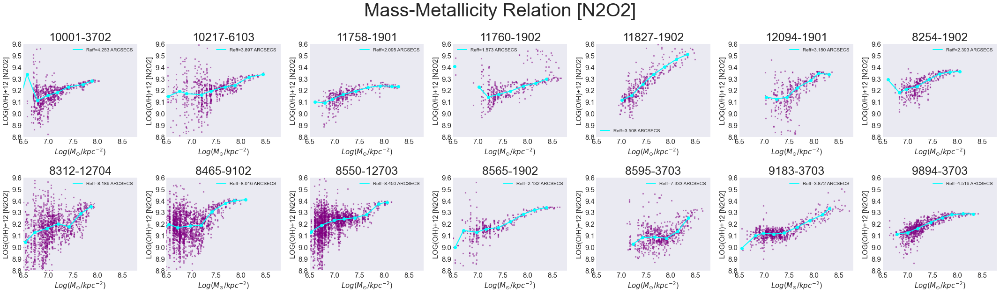

In [509]:
bbrd_fits_file_list = glob.glob("/Users/mmckay/Desktop/research/FMR_MZR/bbrd_MMfits/*.fits")
bbrd_csv_file_list = glob.glob("/Users/mmckay/Desktop/research/FMR_MZR/bbrd_MMfits/*.csv")

# Plot Mosaic of BBRD sample D4000 Maps from Pipe3D
fig = plt.figure(figsize=(30,9), constrained_layout=True)

#axs = [ax0,ax1,ax2,ax3,ax4,ax5,ax6,ax7,ax8,ax9,ax10,ax11,ax12,ax13]
for bbrd_fits, bbrd_csv, num in zip(np.sort(bbrd_fits_file_list), np.sort(bbrd_csv_file_list), np.linspace(1,14,14)):
    # Read in FITS data
    hdu = fits.open(bbrd_fits)
    #print(int(num), bbrd_fits, bbrd_csv)
    # ageL_map = hdu['GYR_LW'].data
    # ageL_err_map = hdu['GYR_ERR'].data
    # r_reff_map = hdu['R/Reff'].data
    # # ellip_r_map = hdu['ELLIP R'].data
    plateifu = hdu[0].header['plateifu']
    reff = hdu[0].header['REFF']

    # Read in CSV data
    df = pd.read_csv(bbrd_csv)
    xdata = df['MSUN/SPX2']
    ydata = df['LOG(O/H)+12_[N2O2]']
    #yerr = df['D4000_ERR']

    # split data in radial bins and 
    bins = np.linspace(5, 8.5, 16)
    digitized = np.digitize(xdata, bins)

    # Calulates the median of each bin
    xdata_bin_meds = [xdata[digitized == i].median() for i in range(1, len(bins))]
    ydata_bin_meds = [ydata[digitized == i].median() for i in range(1, len(bins))]
    ydata_bin_stds = [ydata[digitized == i].std() for i in range(1, len(bins))]
    #yerr_bin_meds = [yerr[digitized == i].median() for i in range(1, len(bins))]

    # set xaxis for bin medians
    #x = bins[:len(xdata_bin_meds)] + .2 # adjust for display offset


    # Plotting
    ax = fig.add_subplot(2,7,int(num))
    ax.scatter(xdata, ydata, s=6, marker='x', alpha=0.5, color='purple')
    ax.scatter(xdata_bin_meds, ydata_bin_meds, alpha=1.0, color='aqua')
    ax.plot(xdata_bin_meds, ydata_bin_meds, alpha=1.0, color='aqua', linewidth='2')
    #ax.plot(x, agel_bin_meds, alpha=1.0, color='black')
    #ax.errorbar(x, agel_bin_meds, yerr=1/(np.array(agel_bin_stds)**2), color='cyan')
    #ax.errorbar(x, ydata_bin_meds, yerr=yerr_bin_meds, color='black', linestyle='--', capsize=3, linewidth=3.0)
    ax.set_ylim(8.8, 9.6)
    ax.set_xlim(6.5, 8.8)
    ax.set_xlabel(r'$Log(M_{\odot}/kpc^{-2})$', fontsize=15)
    ax.set_ylabel('LOG(O/H)+12 [N2O2]', fontsize=15)
    ax.set_title('{}'.format(plateifu), fontsize=25)
    plt.xticks(fontsize=15)
    plt.yticks(fontsize=15)
    ax.legend(["Reff={}".format(reff)])
    #ax.axhline(1.4, color='black')

plt.suptitle('Mass-Metallicity Relation [N2O2]', fontsize=40)  
plt.tight_layout(pad=2)
plt.savefig("/Users/mmckay/Desktop/research/FMR_MZR/bbrd_MMfits/bbrd_MZRn2o2_radpro.jpeg") # not displaying colorbar
plt.show()

# Star-Forming Main Sequence

/Users/mmckay/conda/envs/marvin_v2/lib/python3.6/site-packages/numpy/lib/nanfunctions.py:1111: RuntimeWarning:

Mean of empty slice

/Users/mmckay/conda/envs/marvin_v2/lib/python3.6/site-packages/numpy/lib/nanfunctions.py:1111: RuntimeWarning:

Mean of empty slice

/Users/mmckay/conda/envs/marvin_v2/lib/python3.6/site-packages/numpy/lib/nanfunctions.py:1111: RuntimeWarning:

Mean of empty slice

/Users/mmckay/conda/envs/marvin_v2/lib/python3.6/site-packages/numpy/lib/nanfunctions.py:1111: RuntimeWarning:

Mean of empty slice

/Users/mmckay/conda/envs/marvin_v2/lib/python3.6/site-packages/numpy/lib/nanfunctions.py:1111: RuntimeWarning:

Mean of empty slice

/Users/mmckay/conda/envs/marvin_v2/lib/python3.6/site-packages/numpy/lib/nanfunctions.py:1111: RuntimeWarning:

Mean of empty slice

/Users/mmckay/conda/envs/marvin_v2/lib/python3.6/site-packages/numpy/lib/nanfunctions.py:1111: RuntimeWarning:

Mean of empty slice

/Users/mmckay/conda/envs/marvin_v2/lib/python3.6/site-packages/numpy/

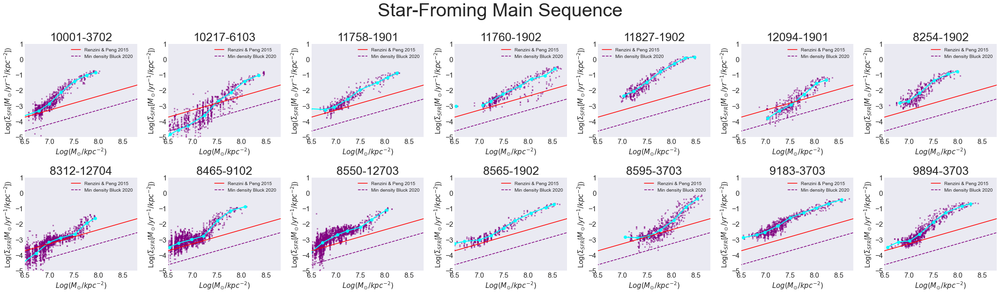

In [513]:
bbrd_fits_file_list = glob.glob("/Users/mmckay/Desktop/research/FMR_MZR/bbrd_MMfits/*.fits")
bbrd_csv_file_list = glob.glob("/Users/mmckay/Desktop/research/FMR_MZR/bbrd_MMfits/*.csv")

# Plot Mosaic of BBRD sample D4000 Maps from Pipe3D
fig = plt.figure(figsize=(30,9), constrained_layout=True)

#axs = [ax0,ax1,ax2,ax3,ax4,ax5,ax6,ax7,ax8,ax9,ax10,ax11,ax12,ax13]
for bbrd_fits, bbrd_csv, num in zip(np.sort(bbrd_fits_file_list), np.sort(bbrd_csv_file_list), np.linspace(1,14,14)):
    # Read in FITS data
    hdu = fits.open(bbrd_fits)
    #print(int(num), bbrd_fits, bbrd_csv)
    # ageL_map = hdu['GYR_LW'].data
    # ageL_err_map = hdu['GYR_ERR'].data
    # r_reff_map = hdu['R/Reff'].data
    # # ellip_r_map = hdu['ELLIP R'].data
    plateifu = hdu[0].header['plateifu']
    reff = hdu[0].header['REFF']

    # Read in CSV data
    df = pd.read_csv(bbrd_csv)
    xdata = df['MSUN/SPX2']
    ydata = df['LOGSFR DENSITY']
    #yerr = df['D4000_ERR']

    # split data in radial bins and 
    bins = np.linspace(5, 9, 16)
    digitized = np.digitize(xdata, bins)

    # Calulates the median of each bin
    xdata_bin_meds = [xdata[digitized == i].median() for i in range(1, len(bins))]
    ydata_bin_meds = [ydata[digitized == i].median() for i in range(1, len(bins))]
    ydata_bin_stds = [ydata[digitized == i].std() for i in range(1, len(bins))]
    #yerr_bin_meds = [yerr[digitized == i].median() for i in range(1, len(bins))]

    # set xaxis for bin medians
    #x = bins[:len(xdata_bin_meds)] + .2 # adjust for display offset


    # Plotting
    ax = fig.add_subplot(2,7,int(num))
    ax.scatter(xdata, ydata, s=6, marker='x', alpha=0.5, color='purple')
    ax.scatter(xdata_bin_meds, ydata_bin_meds, alpha=1.0, color='aqua')
    ax.plot(xdata_bin_meds, ydata_bin_meds, alpha=1.0, color='aqua', linewidth='2')
    #ax.plot(x, agel_bin_meds, alpha=1.0, color='black')
    #ax.errorbar(x, agel_bin_meds, yerr=1/(np.array(agel_bin_stds)**2), color='cyan')
    #ax.errorbar(x, ydata_bin_meds, yerr=yerr_bin_meds, color='black', linestyle='--', capsize=3, linewidth=3.0)
    ax.set_ylim(-5, 1)
    ax.set_xlim(6.5, 8.8)
    ax.set_xlabel(r'$Log(M_{\odot}/kpc^{-2})$', fontsize=15)
    ax.set_ylabel(r'Log($\Sigma_{SFR}$[$M_\odot/yr^{-1}/kpc^{-2}$])', fontsize=15)
    ax.set_title('{}'.format(plateifu), fontsize=25)
    plt.xticks(fontsize=15)
    plt.yticks(fontsize=15)


    logm_list = np.arange(5.0, 11.0, 0.1)
    sfms_fit = 0.90 * logm_list - 9.57
    ax.plot(logm_list, sfms_fit, color='red', label='Renzini & Peng 2015')
    ax.plot(logm_list, sfms_fit-0.9, color='purple', label='Min density Bluck 2020', linestyle='--')
    ax.legend(fontsize='10')
    # ax.legend(["Reff={}".format(reff)])
    #ax.axhline(1.4, color='black')

plt.suptitle('Star-Froming Main Sequence', fontsize=40)  
plt.tight_layout(pad=2)
plt.savefig("/Users/mmckay/Desktop/research/FMR_MZR/bbrd_MMfits/bbrd_sfms.jpeg") # not displaying colorbar
plt.show()

In [ ]:
# This code is used to Download MaNGA DAP maps from MPL-11
# 1. Dowmload data from https://data.sdss.org/sas/mangawork/manga/spectro/analysis/MPL-11/HYB10-MILESHC-MASTARSSP/ to a harddrive
# 2. Extract needed data to new FITS file -> see if I can edit a function or 2 in gererate fits notebook
# 3. Push code to Git for how to rememmber to download data from MPL-11


In [25]:
# file_path = '/Volumes/lil_oynx/bbrd_dapfits/manga-8254-1902-MAPS-HYB10-MILESHC-MASTARSSP.fits'
# hdu = fits.open(file_path)
# hdu.info()

Filename: /Volumes/lil_oynx/bbrd_dapfits/manga-8254-1902-MAPS-HYB10-MILESHC-MASTARSSP.fits
No.    Name      Ver    Type      Cards   Dimensions   Format
  0  PRIMARY       1 PrimaryHDU     147   ()      
  1  SPX_SKYCOO    1 ImageHDU        44   (32, 32, 2)   float32   
  2  SPX_ELLCOO    1 ImageHDU        49   (32, 32, 4)   float32   
  3  SPX_MFLUX     1 ImageHDU        37   (32, 32)   float32   
  4  SPX_MFLUX_IVAR    1 ImageHDU        38   (32, 32)   float32   
  5  SPX_SNR       1 ImageHDU        35   (32, 32)   float32   
  6  BINID         1 ImageHDU        46   (32, 32, 5)   int32   
  7  BIN_LWSKYCOO    1 ImageHDU        44   (32, 32, 2)   float32   
  8  BIN_LWELLCOO    1 ImageHDU        49   (32, 32, 4)   float32   
  9  BIN_AREA      1 ImageHDU        36   (32, 32)   float32   
 10  BIN_FAREA     1 ImageHDU        35   (32, 32)   float32   
 11  BIN_MFLUX     1 ImageHDU        38   (32, 32)   float32   
 12  BIN_MFLUX_IVAR    1 ImageHDU        39   (32, 32)   float32   
 13

In [46]:
# hdu[0].header['*']

In [47]:
# file_path = '/Volumes/lil_onyx/bbrd_Pipe3Dfits/manga-10001-3702.Pipe3D.cube.fits'
# hdu = fits.open(file_path)

# hdu.info()

In [48]:
# file_path = '/Volumes/lil_onyx/bbrd_Pipe3Dfits/manga-8254-1902.Pipe3D.cube.fits'
# hdu = fits.open(file_path)

# hdu.info()

In [49]:
# hdu[1].header['*']

In [14]:
# ha_elflux_map1 = hdu[23].data[24]
# ha_elflux_map2 = hdu[30].data[24]

In [34]:


#px.imshow(np.log10(ha_elflux_map1))

In [35]:
# px.imshow(np.log10(ha_elflux_map2))

In [23]:


bbrd_df = pd.read_csv('/Users/mmckay/Desktop/research/FMR_MZR/final_MaNGAdr16_bbrd_crossmatch.csv')
bbrd_df.count()

Unnamed: 0                 14
Objra                      14
Objdec                     14
mangaid                    14
plateifu                   14
nsa_z                      14
SDSS_RA_deg                14
SDSS_DEC_deg               14
SDSS_z                     14
DR16_match_sep2d_deg       14
DR16_match_sep2d_arcsec    14
dtype: int64

In [24]:
lg12_df = pd.read_csv('/Users/mmckay/Desktop/research/FMR_MZR/final_MaNGAdr16_lg12_crossmatch.csv')
lg12_df.count()

Unnamed: 0                 268
Objra                      268
Objdec                     268
mangaid                    268
plateifu                   268
nsa_z                      268
SDSS_RA_deg                268
SDSS_DEC_deg               268
SDSS_z                     268
DR16_match_sep2d_deg       268
DR16_match_sep2d_arcsec    268
dtype: int64

In [42]:
for i,j in zip(bbrd_df['nsa_z'][], bbrd_df['plateifu']):
    print(i,j)

0.0256063 10001-3702
0.0470016 10217-6103
0.025356574 11758-1901
0.049425263 11760-1902
0.02552837 11827-1902
0.04427569 12094-1901
0.024237099999999998 8254-1902
0.029592700000000003 8312-12704
0.0276805 8465-9102
0.0298122 8550-12703
0.0421768 8565-1902
0.0296268 8595-3703
0.0233453 9183-3703
0.0229775 9894-3703


In [43]:
dap_gal_fits = fits.open("/Volumes/lil_oynx/bbrd_dapfits/manga-{}-MAPS-HYB10-MILESHC-MASTARSSP.fits".format('10001-3702'))

FileNotFoundError: [Errno 2] No such file or directory: '/Volumes/lil_oynx/bbrd_dapfits/manga-10001-3702-MAPS-HYB10-MILESHC-MASTARSSP.fits'